# Generating synthetic image with Image Variation Transformers

https://huggingface.co/lambdalabs/sd-image-variations-diffusers

In [1]:
#pip install transformers
#pip install accelerate
#pip install torchvision

In [2]:
import datetime
import time
import os
import cv2
#import ipywidgets as widgets
#import IPython.display as display
import sys

from diffusers import StableDiffusionImageVariationPipeline
from IPython.display import Image
from matplotlib import pyplot as plt
from PIL import Image as PILimage
from torchvision import transforms

%matplotlib inline

In [3]:
sys.version

'3.8.5 (default, Sep  4 2020, 07:30:14) \n[GCC 7.3.0]'

In [4]:
!nvidia-smi -L

GPU 0: Tesla K80 (UUID: GPU-5a041c75-0696-161c-55a5-3262d01a9fcc)
GPU 1: Tesla K80 (UUID: GPU-d6d5ca49-a617-99c2-a48f-e7e4c696487a)
GPU 2: Tesla K80 (UUID: GPU-ec28b10e-ecfb-2abe-9809-13ad3dc5446f)
GPU 3: Tesla K80 (UUID: GPU-b81da577-490f-d556-c3d8-8d744a168142)


In [5]:
def display_side_by_side(image1, image2):
    """
    Displaying two images side by side
    """
    img1 = cv2.cvtColor(cv2.imread(image1), cv2.COLOR_BGR2RGB)
    img2 = cv2.cvtColor(cv2.imread(image2), cv2.COLOR_BGR2RGB)

    fig = plt.figure(figsize=(25, 10))
    ax1 = fig.add_subplot(1, 2, 1) 
    plt.title('Input image: ' + image1, fontsize=18, color='Blue')
    ax1.axis('off')

    ax2 = fig.add_subplot(1, 2, 2)
    plt.title('Generated image: ' + image2, fontsize=18, color='Green')
    ax2.axis('off')

    ax1.imshow(img1)
    ax2.imshow(img2)

In [6]:
def image_to_image(image_filename):
    """
    Image to image
    """
    start = time.time()

    print("Image to image: generation of an artificial image of",
          image_filename)
    im = PILimage.open(image_filename)  # Reading image

    tform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize(
            (224, 224),
            interpolation=transforms.InterpolationMode.BICUBIC,
            antialias=False,
        ),
        transforms.Normalize([0.48145466, 0.4578275, 0.40821073],
                             [0.26862954, 0.26130258, 0.27577711]),
    ])

    inp = tform(im).to(device).unsqueeze(0)
    out = sd_pipe(inp, guidance_scale=3)

    now = str(datetime.datetime.today().strftime('%d%b%Y_%H%M%S'))
    output_image = os.path.splitext(input_image)[0] +\
    '_synthetic_image_' + now + '.jpg'
    out["images"][0].save(output_image)  # Saving image
    print("Saved image:", output_image)

    elapsed = time.time() - start
    print("\nDone in " + time.strftime(
        "%H:%M:%S.{}".format(str(elapsed % 1)[2:])[:15], time.gmtime(elapsed)))

    return output_image

In [7]:
device = "cuda:0"

sd_pipe = StableDiffusionImageVariationPipeline.from_pretrained(
    "lambdalabs/sd-image-variations-diffusers",
    revision="v2.0",
)

sd_pipe = sd_pipe.to(device)

Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

## Let's test using some images

### Example 1

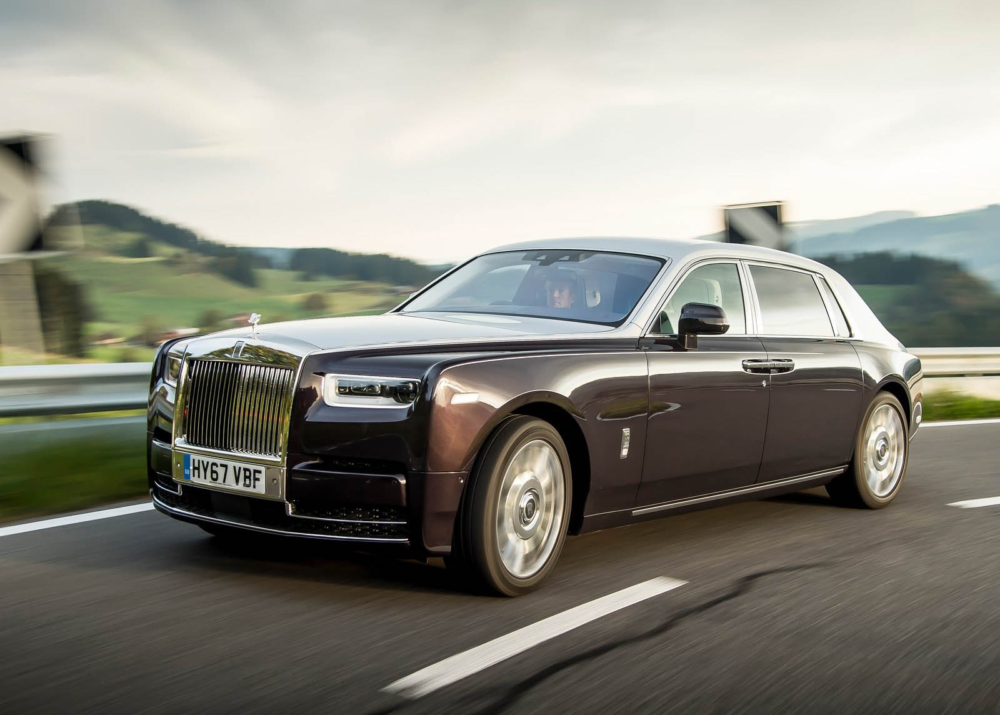

In [34]:
input_image = 'car.jpg'

Image(filename=input_image, width=600)

In [35]:
output_image = image_to_image(input_image)

Image to image: generation of an artificial image of car.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: car_synthetic_image_08Feb2023_104535.jpg

Done in 00:01:12.752052


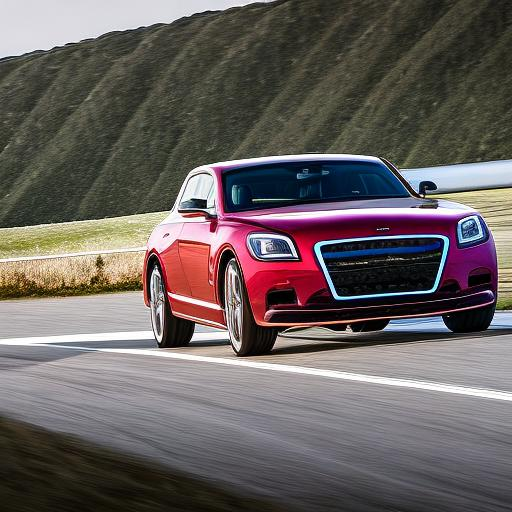

In [36]:
Image(filename=output_image, width=600)

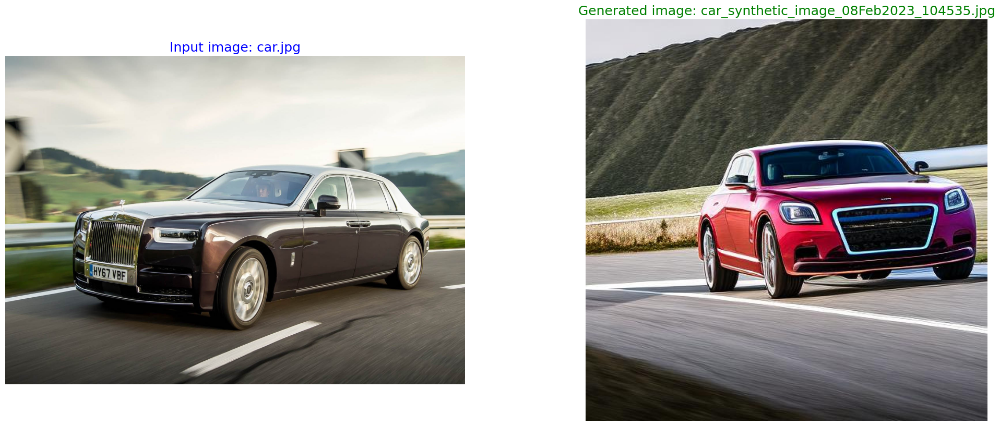

In [37]:
display_side_by_side(input_image, output_image)

### Example 2

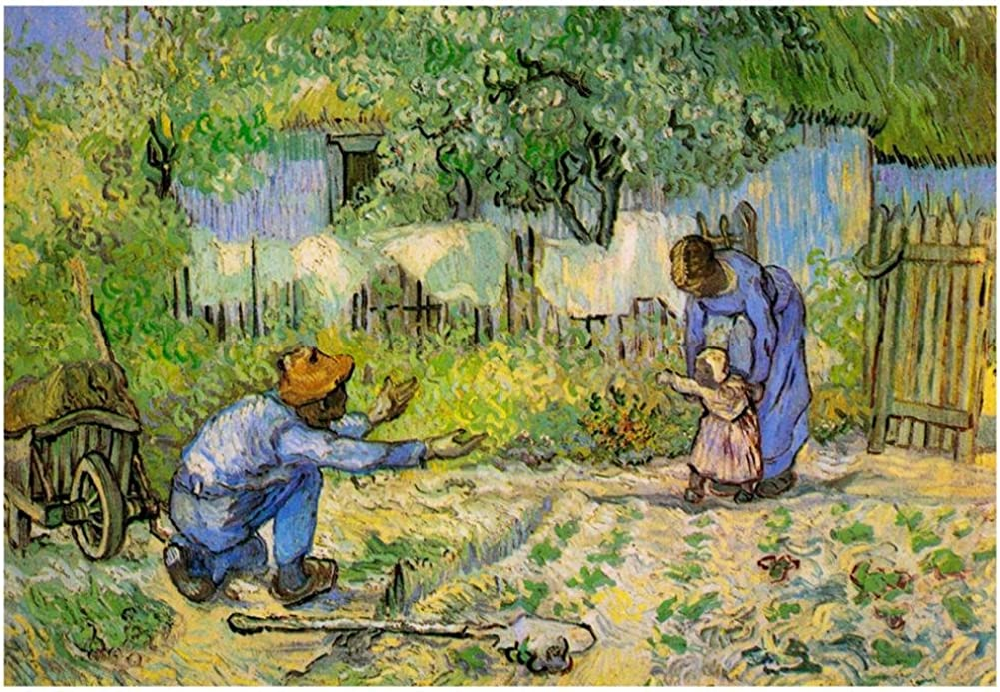

In [12]:
input_image = 'VanGogh.jpg'

Image(filename=input_image, width=600)

Image to image: generation of an artificial image of VanGogh.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: VanGogh_synthetic_image_08Feb2023_100437.jpg

Done in 00:01:12.791313


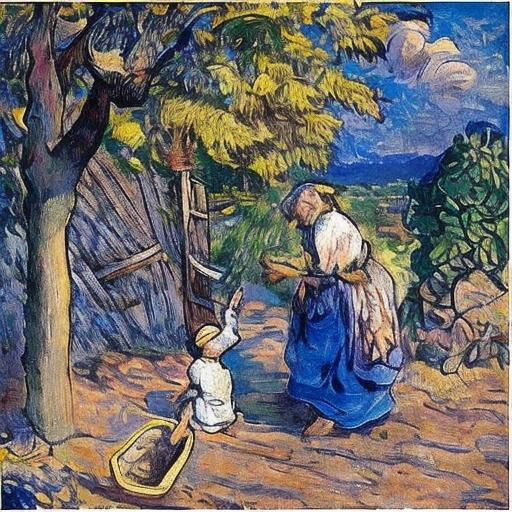

In [13]:
output_image = image_to_image(input_image)
Image(filename=output_image, width=600)

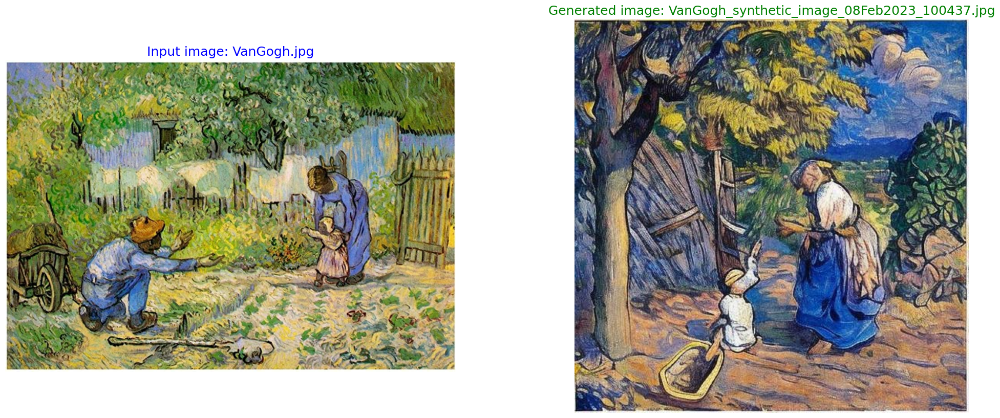

In [14]:
display_side_by_side(input_image, output_image)

### Example 3

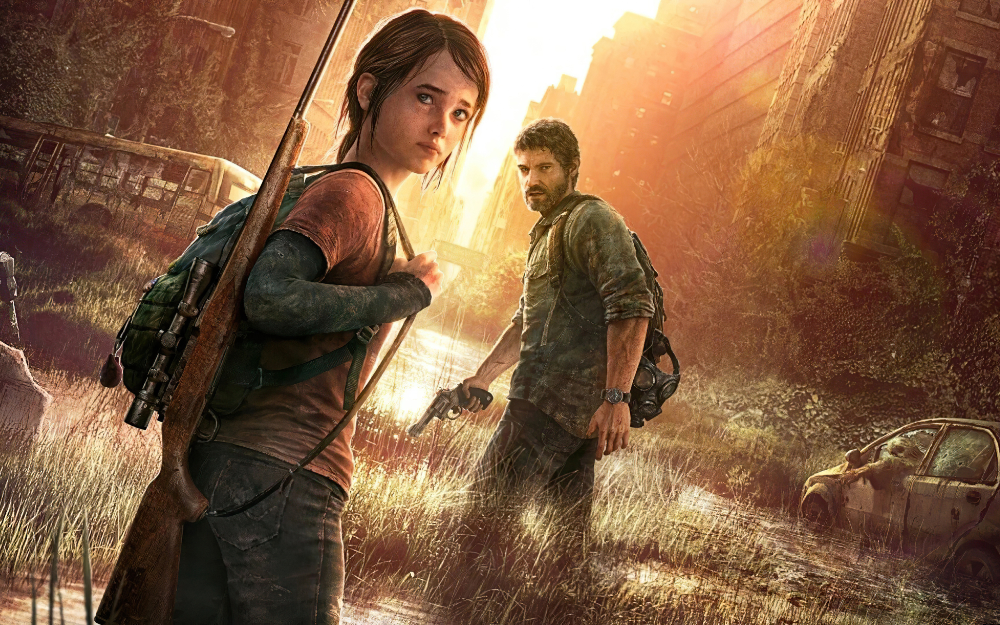

In [15]:
input_image = 'movie.jpg'

Image(filename=input_image, width=600)

Image to image: generation of an artificial image of movie.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: movie_synthetic_image_08Feb2023_100552.jpg

Done in 00:01:13.673004


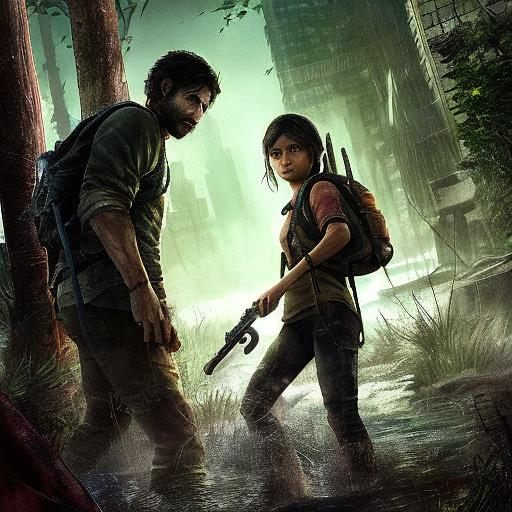

In [16]:
output_image = image_to_image(input_image)
Image(filename=output_image, width=600)

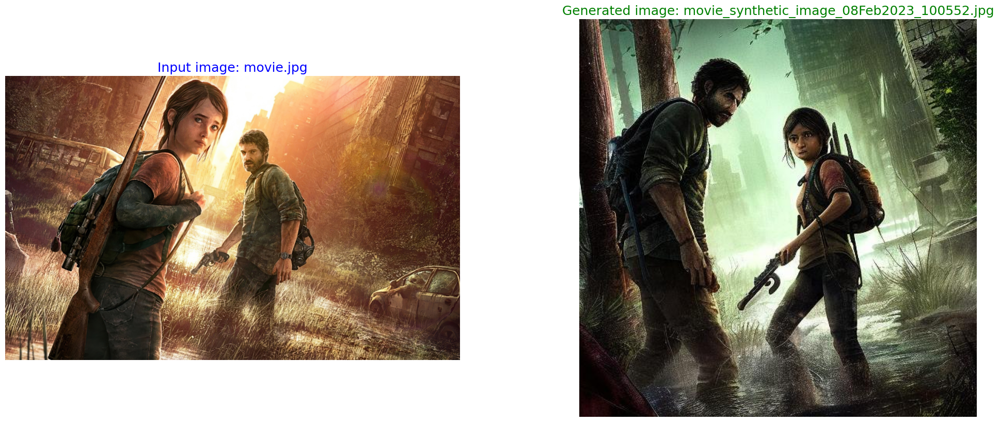

In [17]:
display_side_by_side(input_image, output_image)

### Example 4

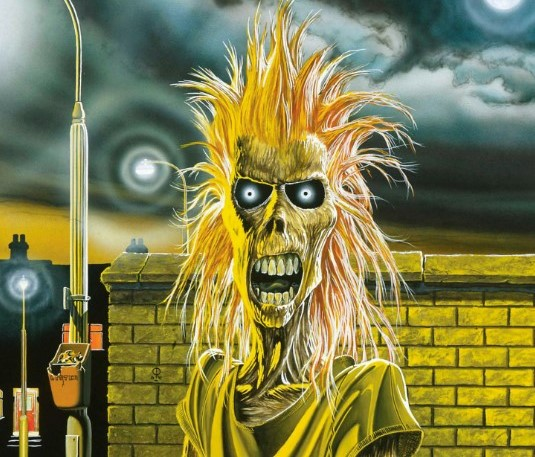

In [38]:
input_image = 'ironmaiden.jpg'

Image(filename=input_image, width=600)

Image to image: generation of an artificial image of ironmaiden.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: ironmaiden_synthetic_image_08Feb2023_104649.jpg

Done in 00:01:12.989585


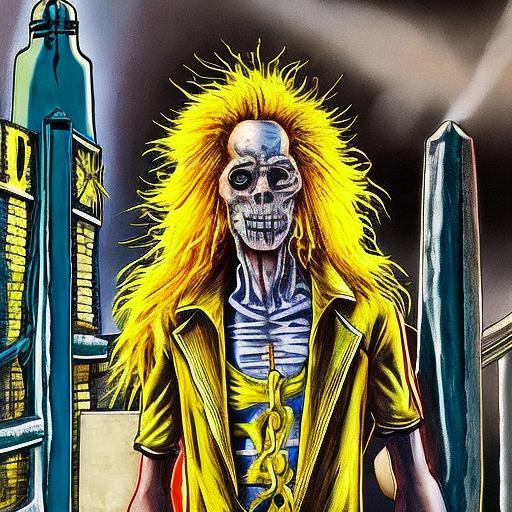

In [39]:
output_image = image_to_image(input_image)
Image(filename=output_image, width=600)

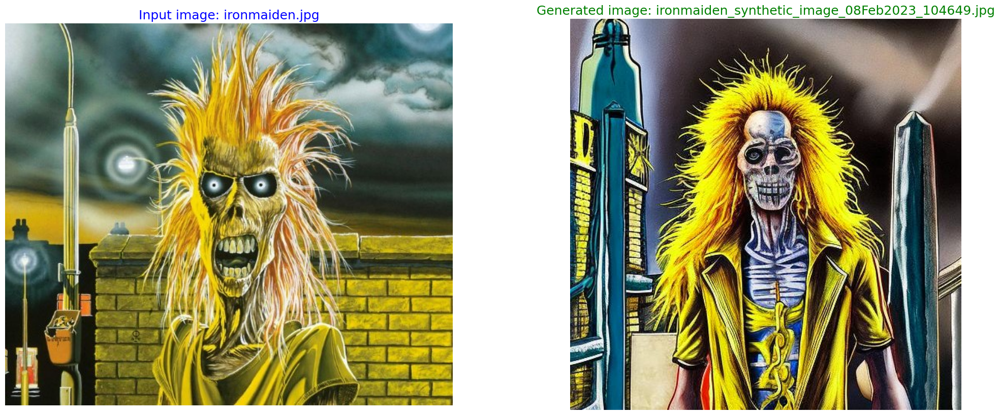

In [40]:
display_side_by_side(input_image, output_image)

## Using some images for computer vision quality control use-cases
> Great if you do not have enough training images for example to build a scratch or a rust detection model

### Example 5

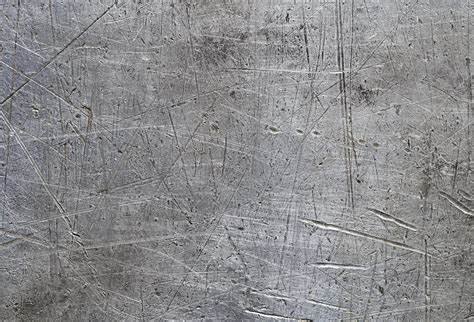

In [21]:
input_image = 'scratch.jpg'

Image(filename=input_image, width=600)

Image to image: generation of an artificial image of scratch.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: scratch_synthetic_image_08Feb2023_100823.jpg

Done in 00:01:13.446718


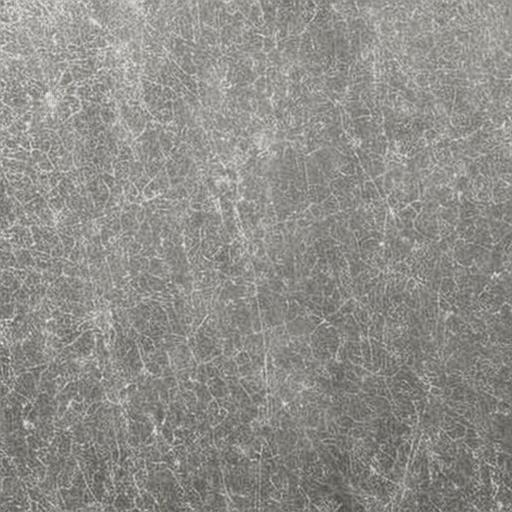

In [22]:
output_image = image_to_image(input_image)
Image(filename=output_image, width=600)

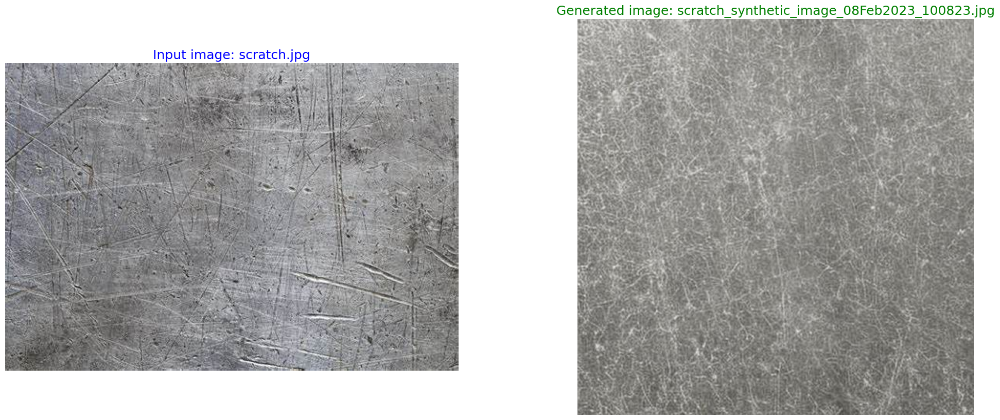

In [23]:
display_side_by_side(input_image, output_image)

### Example 6

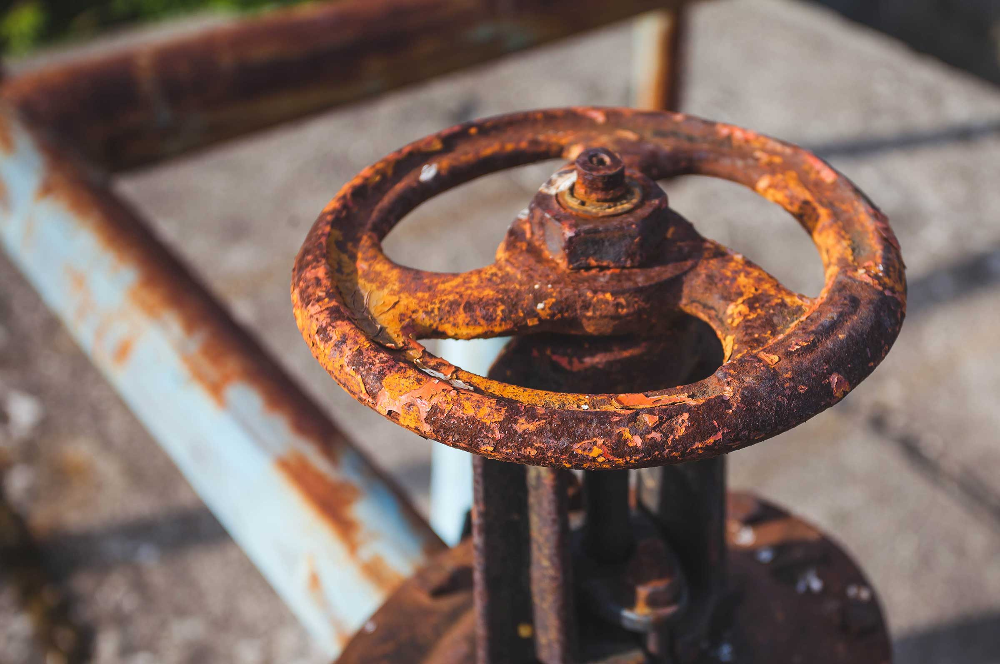

In [24]:
input_image = 'rust.jpg'

Image(filename=input_image, width=600)

Image to image: generation of an artificial image of rust.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: rust_synthetic_image_08Feb2023_100938.jpg

Done in 00:01:13.940008


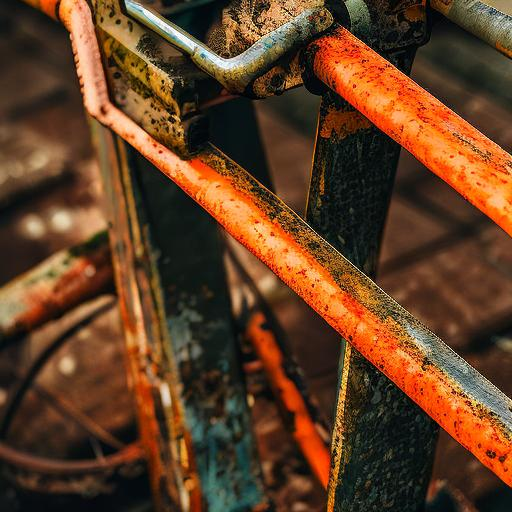

In [25]:
output_image = image_to_image(input_image)
Image(filename=output_image, width=600)

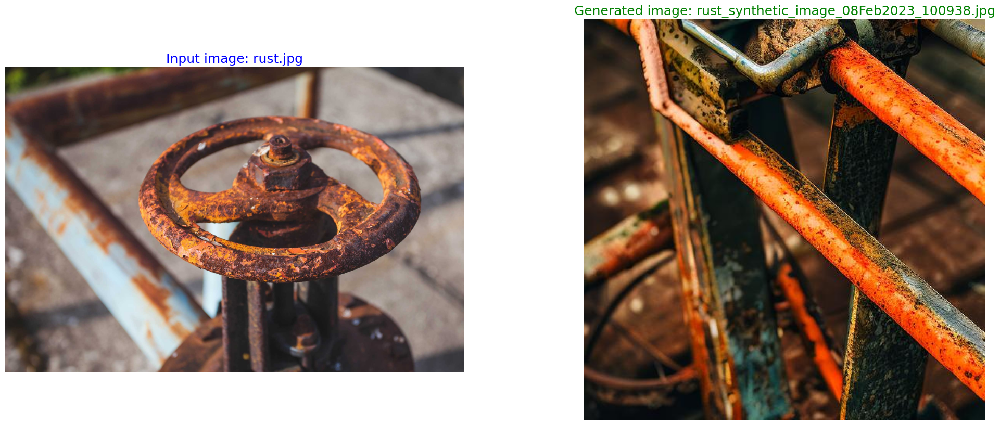

In [26]:
display_side_by_side(input_image, output_image)

Image to image: generation of an artificial image of rust.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

Saved image: rust_synthetic_image_08Feb2023_101054.jpg

Done in 00:01:14.248309


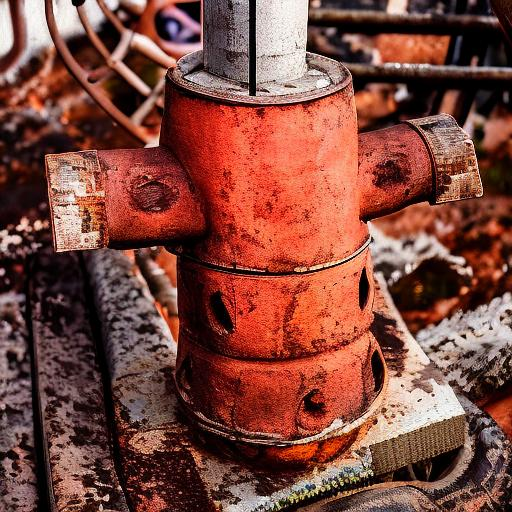

In [27]:
output_image = image_to_image(input_image)
Image(filename=output_image, width=600)

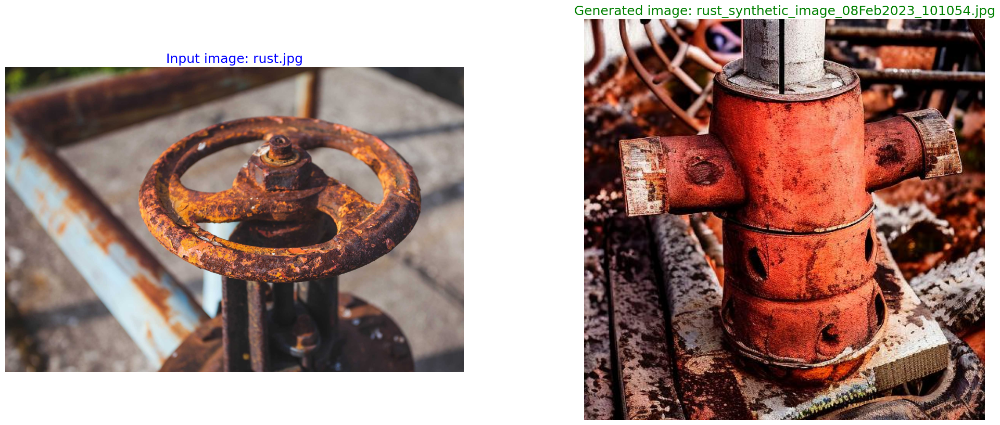

In [28]:
display_side_by_side(input_image, output_image)

## List of generated images

In [33]:
!ls *synthetic_image*.jpg -lh

-rwxrwxrwx 1 root root 87K Feb  8 10:04 VanGogh_synthetic_image_08Feb2023_100437.jpg
-rwxrwxrwx 1 root root 61K Feb  8 10:03 car_synthetic_image_08Feb2023_100323.jpg
-rwxrwxrwx 1 root root 85K Feb  8 10:07 ironmaiden_synthetic_image_08Feb2023_100708.jpg
-rwxrwxrwx 1 root root 65K Feb  8 10:05 movie_synthetic_image_08Feb2023_100552.jpg
-rwxrwxrwx 1 root root 54K Feb  8 10:09 rust_synthetic_image_08Feb2023_100938.jpg
-rwxrwxrwx 1 root root 79K Feb  8 10:10 rust_synthetic_image_08Feb2023_101054.jpg
-rwxrwxrwx 1 root root 68K Feb  8 10:12 rust_synthetic_image_08Feb2023_101210.jpg
-rwxrwxrwx 1 root root 66K Feb  8 10:13 rust_synthetic_image_08Feb2023_101326.jpg
-rwxrwxrwx 1 root root 53K Feb  8 10:08 scratch_synthetic_image_08Feb2023_100823.jpg
